In [2]:
# Preliminaries 
import os # to handle path information
import nibabel as nb
import numpy as np
import h5py
import pandas as pd
import surfAnalysisPy as surf
import matplotlib.pyplot as plt

return_subjs = np.array([2,3,4,6,8,9,10,12,14,15,17,18,19,20,21,22,24,25,26,27,28,29,30,31])

baseDir = '/Volumes/diedrichsen_data$/data/super_cerebellum'
surfDir = baseDir + '/sc1/surfaceWB'

hem = ['L','R']
hem_name = ['CortexLeft','CortexRight']

import ipywidgets as widgets       # interactive display
%config InlineBackend.figure_format = 'svg' # other available formats are: 'retina', 'png', 'jpeg', 'pdf'


In [3]:
flatsurf = []
inflsurf = [] 

for h,hemN in enumerate(hem):
    flatname = os.path.join(surfDir,'group32k','fs_LR.32k.' + hemN + '.flat.surf.gii')
    inflname = os.path.join(surfDir,'group32k','fs_LR.32k.' + hemN + '.inflated.surf.gii')
    flatsurf.append(nb.load(flatname))
    inflsurf.append(nb.load(flatname))
    

In [4]:
# Plot s02 task maps 
subj = 's02'
taskmap = []
for h,hemN in enumerate(hem):
    name = os.path.join(surfDir,'glm7',subj,subj + '.' + hemN + '.sc1.wcon.func.gii')
    taskmap.append(nb.load(name))
colnames = surf.map.get_gifti_column_names(taskmap[0])
colmap  = [] 
for i,name in enumerate(colnames):
    colmap.append((name,i))

In [5]:
# Load the task maps and center 
YL = np.vstack(taskmap[0].agg_data())
YR = np.vstack(taskmap[1].agg_data())
YL = YL-YL.mean(axis=0)
YR = YR-YR.mean(axis=0)

In [6]:
# Plot the task maps
task = 4
fig = plt.figure(figsize=(12,5))
ax1 = plt.subplot(1,2,1)
ax2 = surf.plot.plotmap(YL[task,:],flatsurf[0],cscale = [-3,3])
ax3 = plt.subplot(1,2,2)
ax4 = surf.plot.plotmap(YR[task,:],flatsurf[1],cscale = [-3,3])
plt.show()
colnames[task]

'VideoKnots'

In [7]:
def plotmap(task): # Plot the task maps
    fig = plt.figure(figsize=(12,5))
    surf.plot.plotmap(YL[task,:],flatsurf[0],cscale = [-3,3])
    colnames[task]

widgets.interact(plotmap,task=colmap)

interactive(children=(Dropdown(description='task', options=(('NoGo', 0), ('Go', 1), ('ToM', 2), ('VideoAct', 3…

<function __main__.plotmap(task)>

In [8]:
def plotscatter(x,y,z):
    fig = plt.figure()
    ax = fig.add_subplot(projection='3d')
    ax.scatter(YL[x,:],YL[y,:],YL[z,:])
    ax.set_xlabel(colnames[x])
    ax.set_ylabel(colnames[y])
    ax.set_zlabel(colnames[z])
    
# widgets.interact(plotscatter,x=colmap,y=colmap,z=colmap)
plotscatter(0,5,3)

<IPython.core.display.Javascript object>


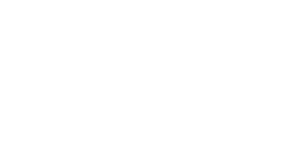

(array([5.820e+02, 3.994e+03, 6.449e+03, 6.022e+03, 4.751e+03, 3.249e+03,
        2.361e+03, 1.498e+03, 9.920e+02, 6.410e+02, 4.530e+02, 3.630e+02,
        2.390e+02, 2.000e+02, 1.230e+02, 7.800e+01, 7.000e+01, 6.400e+01,
        4.100e+01, 3.500e+01, 2.400e+01, 2.500e+01, 2.000e+01, 2.500e+01,
        1.300e+01, 1.700e+01, 1.700e+01, 1.100e+01, 1.200e+01, 9.000e+00,
        3.000e+00, 4.000e+00, 1.000e+00, 1.000e+00, 1.000e+00, 0.000e+00,
        2.000e+00, 1.000e+00, 1.000e+00, 2.000e+00]),
 array([ 2.40049  ,  4.3947887,  6.3890877,  8.383387 , 10.377686 ,
        12.3719845, 14.366283 , 16.360582 , 18.354881 , 20.34918  ,
        22.34348  , 24.337778 , 26.332077 , 28.326376 , 30.320675 ,
        32.314976 , 34.309273 , 36.303574 , 38.29787  , 40.29217  ,
        42.28647  , 44.28077  , 46.275066 , 48.269367 , 50.263664 ,
        52.257965 , 54.252262 , 56.246563 , 58.24086  , 60.23516  ,
        62.229458 , 64.223755 , 66.218056 , 68.21236  , 70.20666  ,
        72.20095  , 74.195

<IPython.core.display.Javascript object>


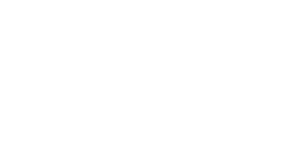

In [34]:
l = np.sqrt(np.sum(YL**2,axis=0))
plt.hist(l,bins=40,rwidth=0.9)